In [ ]:
!mkdir ~/.kaggle

In [ ]:
!pwd


/content


In [ ]:
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets list -s 'Leaf Disease Dataset (combination)'


ref                                                         title                                         size  lastUpdated          downloadCount  voteCount  usabilityRating  
----------------------------------------------------------  -------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
asheniranga/leaf-disease-dataset-combination                Leaf Disease Dataset (combination)           761MB  2022-01-09 14:23:28           2449         45  0.75             
alinedobrovsky/plant-disease-classification-merged-dataset  Plant Disease Classification Merged Dataset   17GB  2023-01-03 15:11:19           5909         68  0.6875           
tolgahayit/yellowrust19-yellow-rust-disease-in-wheat        YELLOW-RUST-19                                 1GB  2021-11-02 13:33:09            656         10  0.5625           
amandam1/healthy-vs-diseased-leaf-image-dataset             Healthy vs. Diseased Leaf Image Dataset        6GB  202

In [ ]:
!kaggle datasets download -d asheniranga/leaf-disease-dataset-combination

Dataset URL: https://www.kaggle.com/datasets/asheniranga/leaf-disease-dataset-combination
License(s): GPL-2.0
100% 759M/761M [00:40<00:00, 22.8MB/s]
100% 761M/761M [00:40<00:00, 19.7MB/s]


In [ ]:
! unzip leaf-disease-dataset-combination.zip

Streaming output truncated to the last 5000 lines.
  inflating: image data/validation/peach/bacterial spot/7e74be0c-cd8c-45fe-80db-66bb30a8a4cc___Rut._Bact.S 0826.JPG  
  inflating: image data/validation/peach/bacterial spot/7f481c3f-bc25-470f-a47b-64962897dae0___Rutg._Bact.S 2246.JPG  
  inflating: image data/validation/peach/bacterial spot/7fd55331-be6b-4554-bdea-009dda8a1302___Rutg._Bact.S 2183.JPG  
  inflating: image data/validation/peach/bacterial spot/81020371-a3d7-421e-94fc-f44cf46be444___Rut._Bact.S 1337.JPG  
  inflating: image data/validation/peach/bacterial spot/810a3211-f2d6-4e0e-86e6-b241946a5c69___Rutg._Bact.S 1206.JPG  
  inflating: image data/validation/peach/bacterial spot/81b31538-0772-47f0-bb9d-3799fa2d296d___Rutg._Bact.S 1549.JPG  
  inflating: image data/validation/peach/bacterial spot/81d21a0e-8551-41e5-b8d6-b5840fc6cda9___Rut._Bact.S 1400.JPG  
  inflating: image data/validation/peach/bacterial spot/82bd1f8e-ec90-4f92-9d62-6f40ebe3f4f3___Rut._Bact.S 0941.JPG  
 

In [ ]:
!mv 'image data' image_data

In [ ]:
%cd image_data

/content/image_data


# **Exploratory Data Analysis**

- This notebook is for the EDA.

- This first step is to navigate through the folder to see the structure.

- The Dataset was already split into test, train, and validation.

- There are 10 classes. 9 different  types of leaf diseases and one class with the healthy images.

- The classes have different number of images. The tomato yellow leaf curl virus class is the class with the most images.

- The insight that I get from the bar graph is that I am working with an imbalance dataset.

- The dataset also contains some low quality images with lighting  issues and some images have a different background (a black ground). This may cause problems for the deep learning part

In [ ]:
## Importing the libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import os
#For working with images:
import PIL
import cv2
import matplotlib.image as mpimg
from PIL import Image
import shutil
from PIL import Image, ImageFilter
import seaborn as sns

In [ ]:
# Define the base path
base_path = '/content/image_data'  # Updated path
# Define the subdirectories
subdirs = ['test', 'train', 'validation']
# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        for item in os.listdir(tomato_path):
            print(f"  - {item}")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /content/image_data/test/tomato:
  - tomato yellow leaf curl virus
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - bacterial spot
  - septoria leaf spot
  - leaf mold
  - spider mites two-spotted spider mite
  - target spot
Contents of /content/image_data/train/tomato:
  - tomato yellow leaf curl virus
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - bacterial spot
  - septoria leaf spot
  - leaf mold
  - spider mites two-spotted spider mite
  - target spot
Contents of /content/image_data/validation/tomato:
  - tomato yellow leaf curl virus
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - bacterial spot
  - septoria leaf spot
  - leaf mold
  - spider mites two-spotted spider mite
  - target spot


In [ ]:
# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        print(f"Number of classes in {subdir}: {len(classes)}")
        for item in classes:
            print(f"  - {item}")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /content/image_data/test/tomato:
Number of classes in test: 10
  - tomato yellow leaf curl virus
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - bacterial spot
  - septoria leaf spot
  - leaf mold
  - spider mites two-spotted spider mite
  - target spot
Contents of /content/image_data/train/tomato:
Number of classes in train: 10
  - tomato yellow leaf curl virus
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - bacterial spot
  - septoria leaf spot
  - leaf mold
  - spider mites two-spotted spider mite
  - target spot
Contents of /content/image_data/validation/tomato:
Number of classes in validation: 10
  - tomato yellow leaf curl virus
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - bacterial spot
  - septoria leaf spot
  - leaf mold
  - spider mites two-spotted spider mite
  - target spot


In [ ]:
# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            num_images = len([img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))])
            print(f"  - {class_name}: {num_images} images")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /content/image_data/test/tomato:
  - tomato yellow leaf curl virus: 535 images
  - early blight: 100 images
  - healthy: 159 images
  - late blight: 190 images
  - tomato mosaic virus: 37 images
  - bacterial spot: 212 images
  - septoria leaf spot: 177 images
  - leaf mold: 95 images
  - spider mites two-spotted spider mite: 167 images
  - target spot: 140 images
Contents of /content/image_data/train/tomato:
  - tomato yellow leaf curl virus: 3858 images
  - early blight: 720 images
  - healthy: 1146 images
  - late blight: 1376 images
  - tomato mosaic virus: 269 images
  - bacterial spot: 1532 images
  - septoria leaf spot: 1276 images
  - leaf mold: 686 images
  - spider mites two-spotted spider mite: 1208 images
  - target spot: 1012 images
Contents of /content/image_data/validation/tomato:
  - tomato yellow leaf curl virus: 964 images
  - early blight: 180 images
  - healthy: 286 images
  - late blight: 343 images
  - tomato mosaic virus: 67 images
  - bacterial spot:

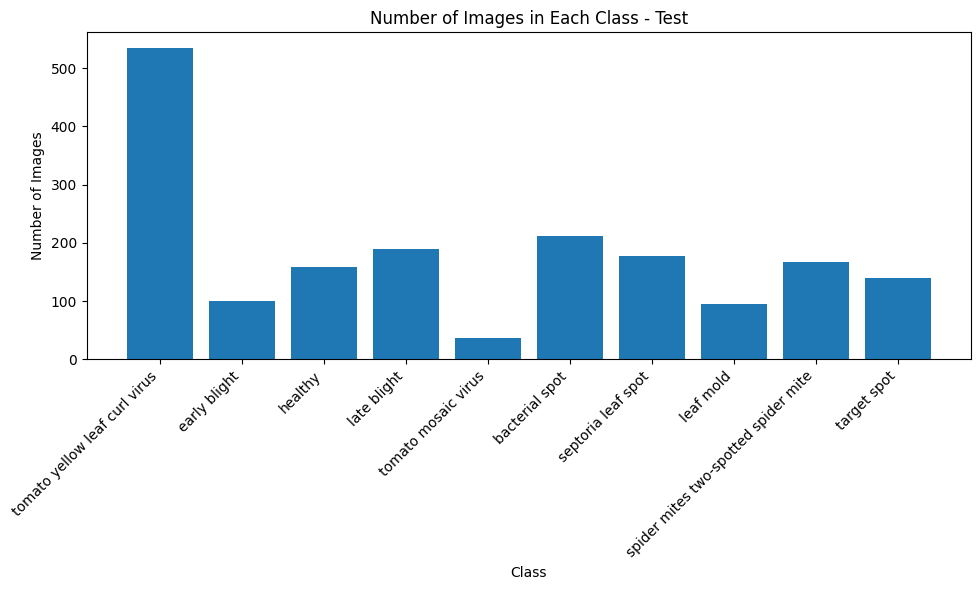

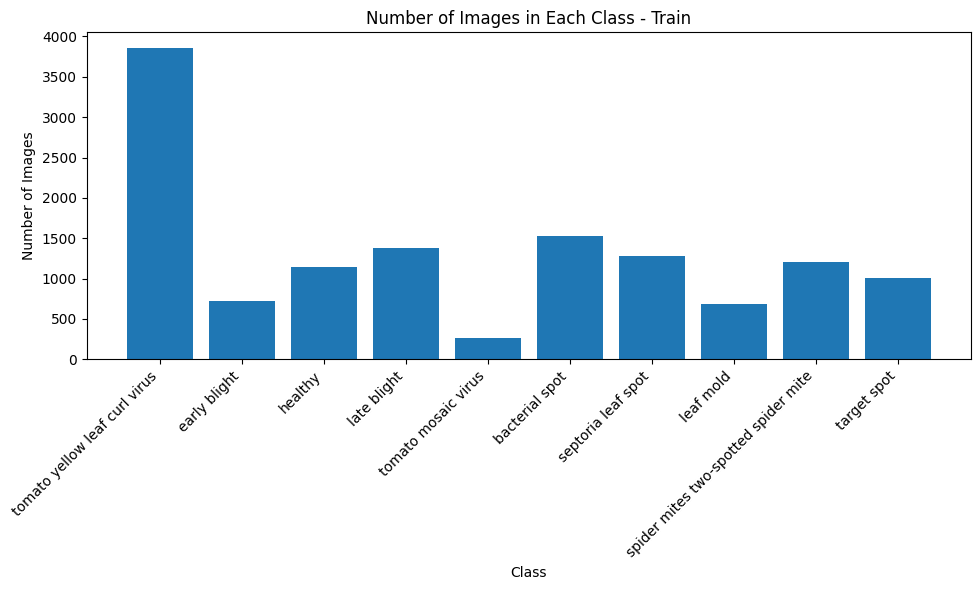

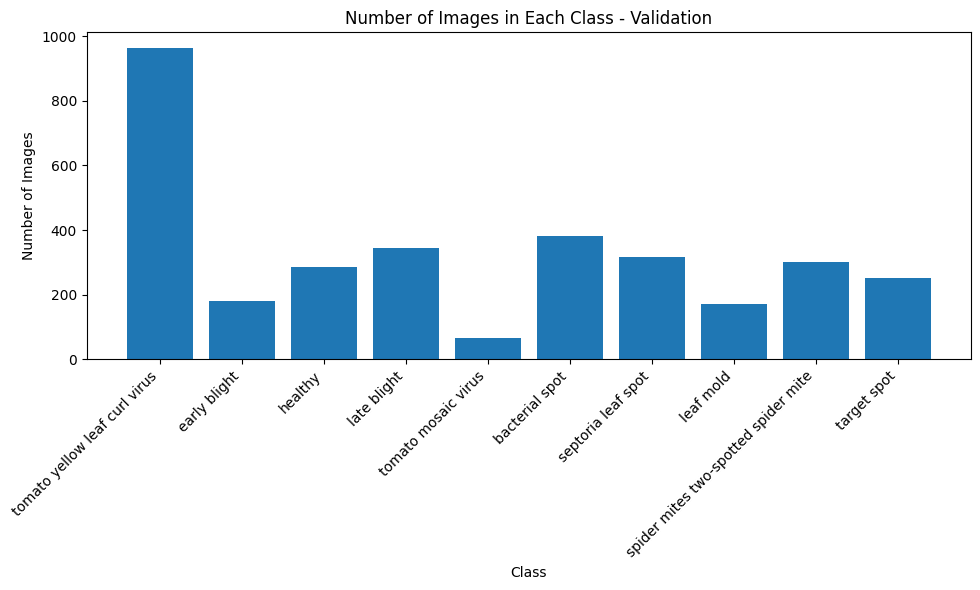

In [ ]:
# Dictionary to store the number of images in each class for each subdirectory
data = {subdir: {} for subdir in subdirs}

# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            num_images = len([img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))])
            data[subdir][class_name] = num_images

# Plotting the data
for subdir, class_data in data.items():
    plt.figure(figsize=(10, 6))
    plt.bar(class_data.keys(), class_data.values())
    plt.xlabel('Class')
    plt.ylabel('Number of Images')
    plt.title(f'Number of Images in Each Class - {subdir.capitalize()}')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

In [ ]:
# Number of images to display per class
num_images_to_display = 3

# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            images = [img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))]
            plt.figure(figsize=(15, 5))
            for i, img_name in enumerate(images[:num_images_to_display]):
                img_path = os.path.join(class_path, img_name)
                img = Image.open(img_path)
                plt.subplot(1, num_images_to_display, i + 1)
                plt.imshow(img)
                plt.title(f'{class_name} - {img_name}')
                plt.axis('off')
            plt.suptitle(f'Images from class: {class_name} ({subdir.capitalize()})')
            plt.show()
    else:
        print(f"{tomato_path} does not exist.")

Output hidden; open in https://colab.research.google.com to view.

### **Visualizing the images with the black background**


In [ ]:
# Iterate through the subdirectories (train, test, validation)
for subdir in ['train', 'test', 'validation']:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        for class_name in os.listdir(tomato_path):
            class_path = os.path.join(tomato_path, class_name)
            if os.path.isdir(class_path):
                for image_name in os.listdir(class_path):
                    image_path = os.path.join(class_path, image_name)
                    if os.path.isfile(image_path):
                        try:
                            img = cv2.imread(image_path)
                            if img is not None:
                                # Check if the background is mostly black
                                if np.mean(img) < 50:  # Adjust the threshold as needed
                                    print(f"Image with black background: {image_path}")
                                    # Display the image
                                    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                                    plt.title(image_path)
                                    plt.show()
                        except Exception as e:
                            print(f"Error processing image {image_path}: {e}")

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# Function to check if an image is blurry
def is_blurry(image_path, threshold=100):
  image = cv2.imread(image_path)
  gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  fm = cv2.Laplacian(gray, cv2.CV_64F).var()
  if fm < threshold:
    return True
  else:
    return False


# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            images = [img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))]
            blurry_images = []
            for img_name in images:
                img_path = os.path.join(class_path, img_name)
                if is_blurry(img_path):
                    blurry_images.append(img_name)
            print(f"  - {class_name}: {len(blurry_images)} blurry images")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /content/image_data/test/tomato:
  - tomato yellow leaf curl virus: 113 blurry images
  - early blight: 0 blurry images
  - healthy: 0 blurry images
  - late blight: 2 blurry images
  - tomato mosaic virus: 0 blurry images
  - bacterial spot: 1 blurry images
  - septoria leaf spot: 0 blurry images
  - leaf mold: 0 blurry images
  - spider mites two-spotted spider mite: 0 blurry images
  - target spot: 0 blurry images
Contents of /content/image_data/train/tomato:
  - tomato yellow leaf curl virus: 932 blurry images
  - early blight: 2 blurry images
  - healthy: 0 blurry images
  - late blight: 17 blurry images
  - tomato mosaic virus: 0 blurry images
  - bacterial spot: 2 blurry images
  - septoria leaf spot: 0 blurry images
  - leaf mold: 0 blurry images
  - spider mites two-spotted spider mite: 0 blurry images
  - target spot: 0 blurry images
Contents of /content/image_data/validation/tomato:
  - tomato yellow leaf curl virus: 219 blurry images
  - early blight: 0 blurry i

Contents of /content/image_data/test/tomato:


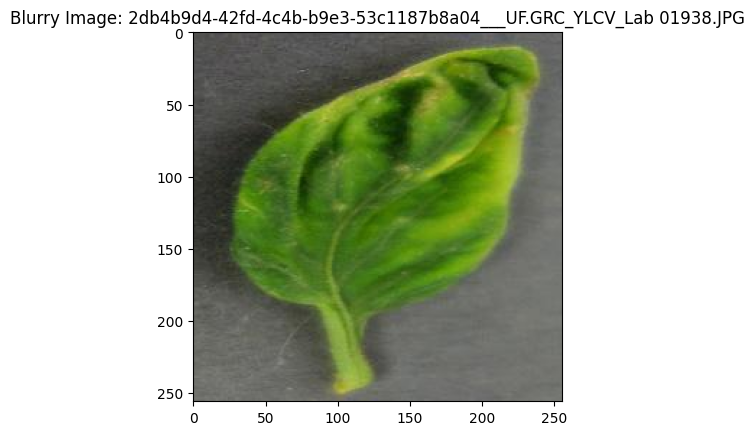

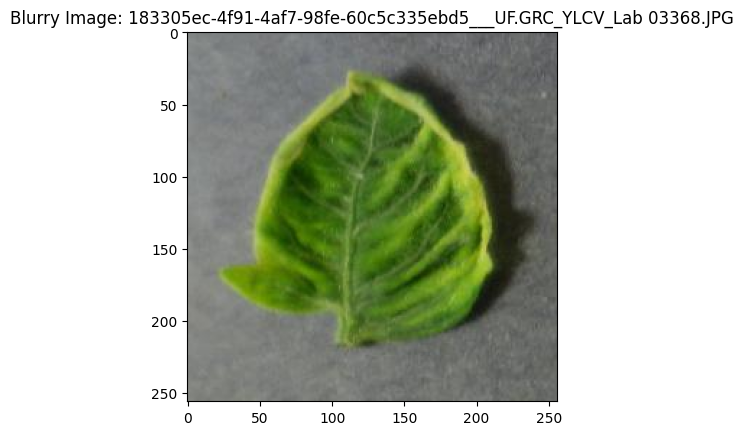

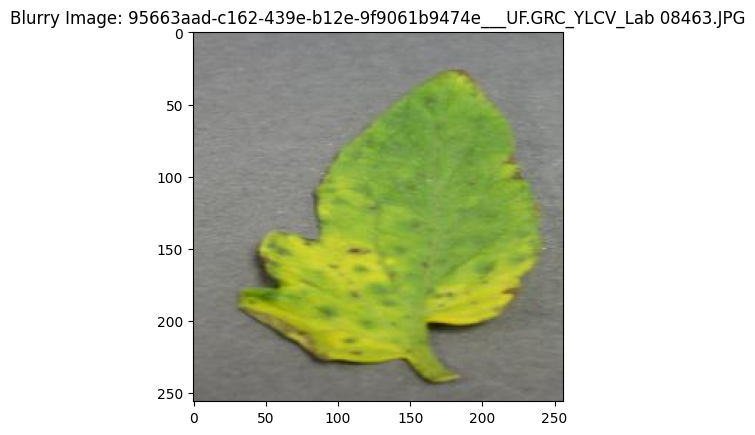

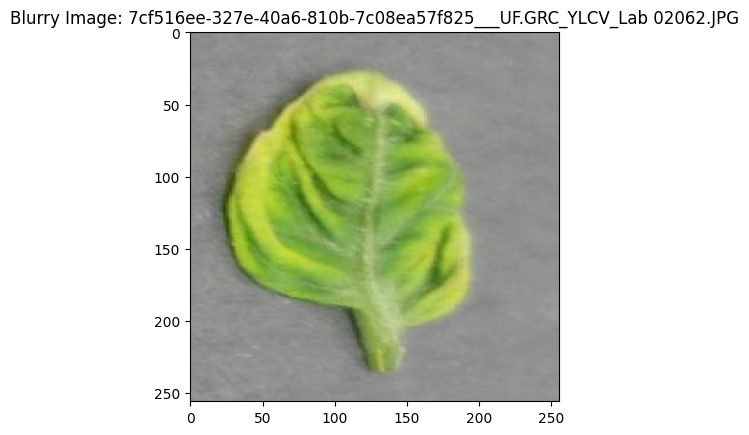

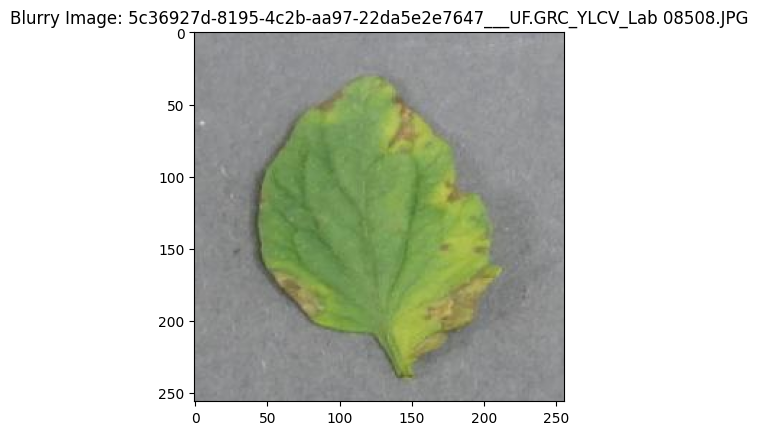

...

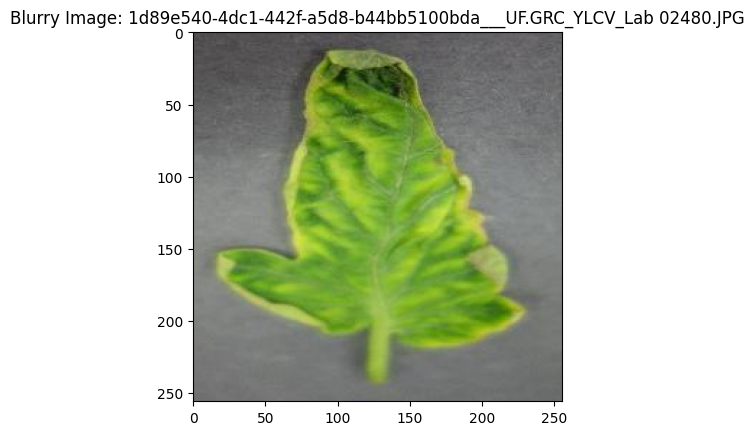

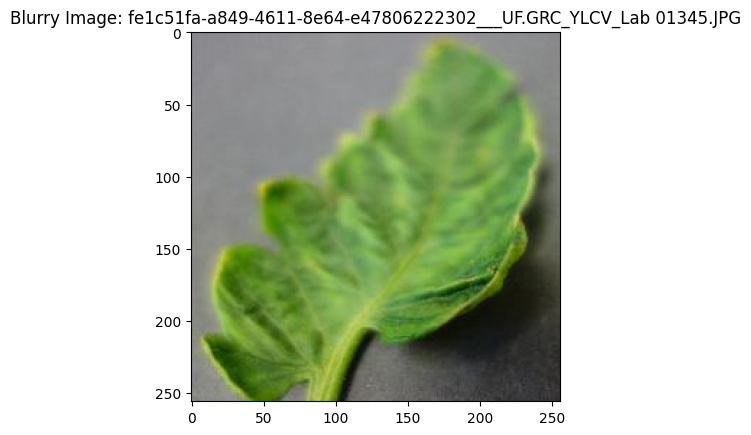

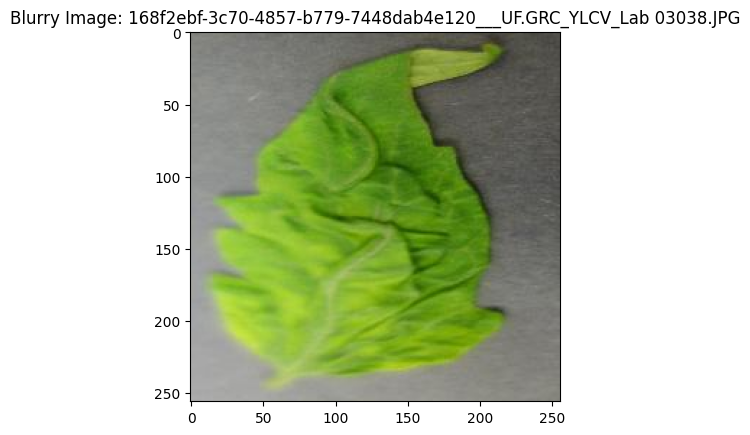

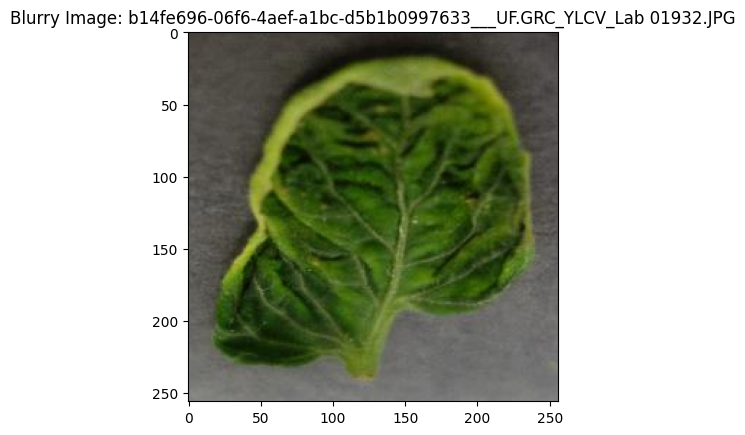

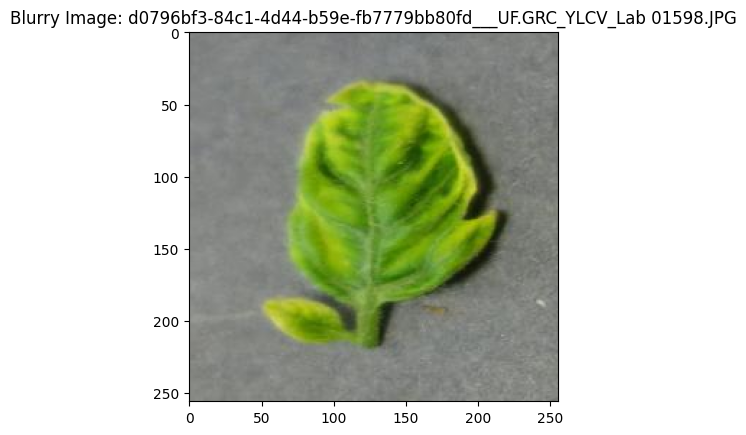

In [ ]:
# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            images = [img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))]
            for img_name in images:
                img_path = os.path.join(class_path, img_name)
                if is_blurry(img_path):
                    img = mpimg.imread(img_path)
                    plt.imshow(img)
                    plt.title(f"Blurry Image: {img_name}")
                    plt.show()
    else:
        print(f"{tomato_path} does not exist.")